# Detectron2 Beginner's Tutorial

<img src="https://dl.fbaipublicfiles.com/detectron2/Detectron2-Logo-Horz.png" width="500">

Welcome to detectron2! This is the official colab tutorial of detectron2. Here, we will go through some basics usage of detectron2, including the following:
* Run inference on images or videos, with an existing detectron2 model
* Train a detectron2 model on a new dataset

You can make a copy of this tutorial or use "File -> Open in playground mode" to play with it yourself.


# Install detectron2

In [1]:
# install dependencies: (use cu100 because colab is on CUDA 10.0)
# !pip install -U torch==1.4+cu100 torchvision==0.5+cu100 -f https://download.pytorch.org/whl/torch_stable.html 
# !pip install cython pyyaml==5.1
# !pip install -U 'git+https://github.com/cocodataset/cocoapi.git#subdirectory=PythonAPI'
import torch, torchvision
torch.__version__
!gcc --version
# opencv is pre-installed on colab

gcc (Ubuntu 7.5.0-3ubuntu1~18.04) 7.5.0
Copyright (C) 2017 Free Software Foundation, Inc.
This is free software; see the source for copying conditions.  There is NO
warranty; not even for MERCHANTABILITY or FITNESS FOR A PARTICULAR PURPOSE.



In [2]:
# install detectron2:
!pip install detectron2 -f https://dl.fbaipublicfiles.com/detectron2/wheels/cu100/index.html

Looking in links: https://dl.fbaipublicfiles.com/detectron2/wheels/cu100/index.html
fastai 1.0.59 requires nvidia-ml-py3, which is not installed.
sagemaker 1.44.0 has requirement requests<2.21,>=2.20.0, but you'll have requests 2.22.0 which is incompatible.
fvcore 0.1.dev200114 has requirement pyyaml>=5.1, but you'll have pyyaml 3.12 which is incompatible.
You are using pip version 10.0.1, however version 20.0.2 is available.
You should consider upgrading via the 'pip install --upgrade pip' command.


In [2]:
# You may need to restart your runtime prior to this, to let your installation take effect
# Some basic setup:
# Setup detectron2 logger
import detectron2
from detectron2.utils.logger import setup_logger
setup_logger()

# import some common libraries
import numpy as np
import cv2
import random
import matplotlib.pyplot as plt
# import some common detectron2 utilities
from detectron2 import model_zoo
from detectron2.engine import DefaultPredictor
from detectron2.config import get_cfg
from detectron2.utils.visualizer import Visualizer
from detectron2.data import MetadataCatalog

# Run a pre-trained detectron2 model

We first download a random image from the COCO dataset:

--2020-03-29 23:28:53--  http://images.cocodataset.org/val2017/000000439715.jpg
Resolving images.cocodataset.org (images.cocodataset.org)... 52.216.140.100
Connecting to images.cocodataset.org (images.cocodataset.org)|52.216.140.100|:80... connected.
HTTP request sent, awaiting response... 200 OK
Length: 209222 (204K) [image/jpeg]
Saving to: ‘input.jpg’

input.jpg           100%[===================>] 204.32K  --.-KB/s    in 0.006s  

2020-03-29 23:28:53 (34.2 MB/s) - ‘input.jpg’ saved [209222/209222]



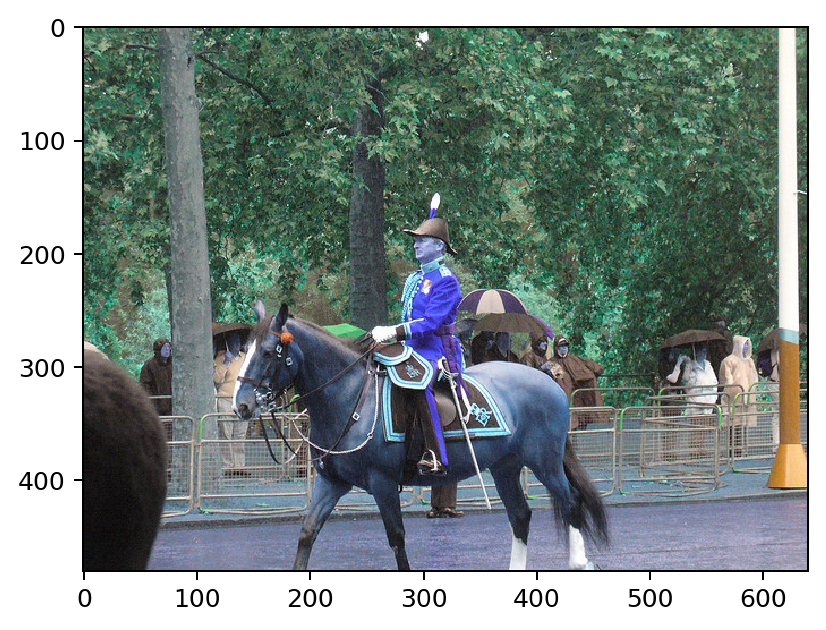

In [3]:
!wget http://images.cocodataset.org/val2017/000000439715.jpg -O input.jpg
im = cv2.imread("./input.jpg")
plt.figure(dpi=180)
plt.imshow(im)

Then, we create a detectron2 config and a detectron2 `DefaultPredictor` to run inference on this image.

In [4]:
cfg = get_cfg()
# add project-specific config (e.g., TensorMask) here if you're not running a model in detectron2's core library
cfg.merge_from_file(model_zoo.get_config_file("COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x.yaml"))
cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.5  # set threshold for this model
# Find a model from detectron2's model zoo. You can use the https://dl.fbaipublicfiles... url as well
cfg.MODEL.WEIGHTS = model_zoo.get_checkpoint_url("COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x.yaml")
predictor = DefaultPredictor(cfg)
outputs = predictor(im)

In [5]:
# look at the outputs. See https://detectron2.readthedocs.io/tutorials/models.html#model-output-format for specification
outputs["instances"].pred_classes
outputs["instances"].pred_boxes

Boxes(tensor([[126.6035, 244.8977, 459.8292, 480.0000],
        [251.1083, 157.8127, 338.9731, 413.6379],
        [114.8496, 268.6864, 148.2352, 398.8111],
        [  0.8217, 281.0327,  78.6072, 478.4210],
        [ 49.3954, 274.1229,  80.1545, 342.9808],
        [561.2248, 271.5816, 596.2755, 385.2552],
        [385.9072, 270.3125, 413.7130, 304.0397],
        [515.9295, 278.3744, 562.2792, 389.3803],
        [335.2409, 251.9167, 414.7491, 275.9375],
        [350.9300, 269.2060, 386.0984, 297.9081],
        [331.6292, 230.9996, 393.2759, 257.2009],
        [510.7349, 263.2656, 570.9865, 295.9194],
        [409.0841, 271.8646, 460.5582, 356.8722],
        [506.8766, 283.3257, 529.9403, 324.0392],
        [594.5663, 283.4820, 609.0577, 311.4124]], device='cuda:0'))

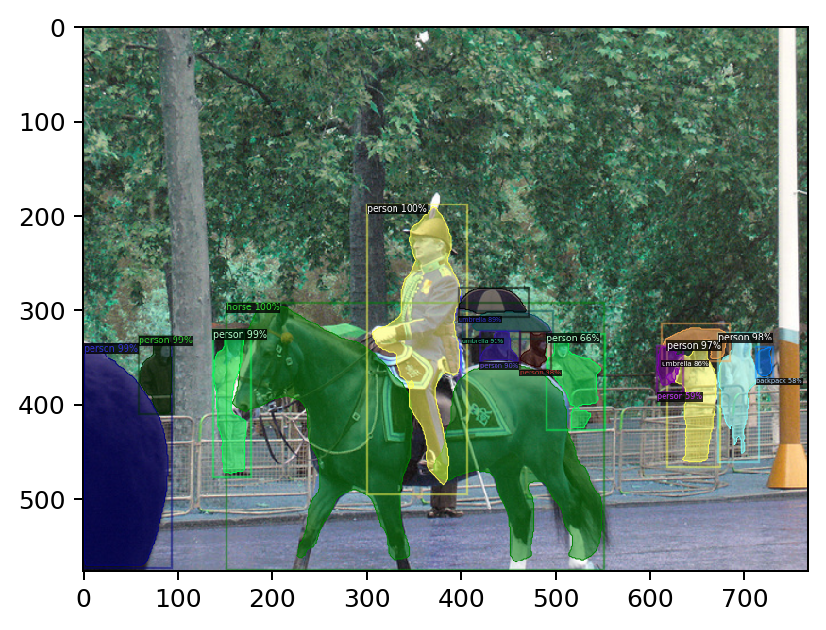

In [6]:
# We can use `Visualizer` to draw the predictions on the image.
v = Visualizer(im[:, :, ::-1], MetadataCatalog.get(cfg.DATASETS.TRAIN[0]), scale=1.2)
v = v.draw_instance_predictions(outputs["instances"].to("cpu"))
plt.figure(dpi=180)
plt.imshow(v.get_image()[:, :, ::-1])


# Train on a custom dataset

In this section, we show how to train an existing detectron2 model on a custom dataset in a new format.

We use [the balloon segmentation dataset](https://github.com/matterport/Mask_RCNN/tree/master/samples/balloon)
which only has one class: balloon.
We'll train a balloon segmentation model from an existing model pre-trained on COCO dataset, available in detectron2's model zoo.

Note that COCO dataset does not have the "balloon" category. We'll be able to recognize this new class in a few minutes.

## Prepare the dataset

In [7]:
# download, decompress the data
# !wget https://github.com/matterport/Mask_RCNN/releases/download/v2.1/balloon_dataset.zip
!unzip manga.zip > /dev/null

In [8]:
# rm -r share_Data

Register the balloon dataset to detectron2, following the [detectron2 custom dataset tutorial](https://detectron2.readthedocs.io/tutorials/datasets.html).
Here, the dataset is in its custom format, therefore we write a function to parse it and prepare it into detectron2's standard format. See the tutorial for more details.


In [12]:
# if your dataset is in COCO format, this cell can be replaced by the following three lines:
# from detectron2.data.datasets import register_coco_instances
# register_coco_instances("my_dataset_train", {}, "json_annotation_train.json", "path/to/image/dir")
# register_coco_instances("my_dataset_val", {}, "json_annotation_val.json", "path/to/image/dir")

import os
import numpy as np
import json
from detectron2.structures import BoxMode
import pdb

def get_balloon_dicts(img_dir):
    json_file = os.path.join(img_dir, "via_export_json.json")
    with open(json_file) as f:
        imgs_anns = json.load(f)
#     pdb.set_trace()
    dataset_dicts = []
    for idx, v in enumerate(imgs_anns.values()):
        record = {}
        
        filename = os.path.join(img_dir, v["filename"])
        height, width = cv2.imread(filename).shape[:2]
        
        record["file_name"] = filename
        record["image_id"] = idx
        record["height"] = height
        record["width"] = width
      
        annos = v["regions"]
        objs = []
#         print(ann÷os)
        for anno in annos:
            assert not anno["region_attributes"]
            anno = anno["shape_attributes"]
            px = anno["all_points_x"]
            py = anno["all_points_y"]
            poly = [(x + 0.5, y + 0.5) for x, y in zip(px, py)]
            poly = [p for x in poly for p in x]

            obj = {
                "bbox": [np.min(px), np.min(py), np.max(px), np.max(py)],
                "bbox_mode": BoxMode.XYXY_ABS,
                "segmentation": [poly],
                "category_id": 0,
                "iscrowd": 0
            }
            objs.append(obj)
        record["annotations"] = objs
        dataset_dicts.append(record)
    return dataset_dicts

from detectron2.data import DatasetCatalog, MetadataCatalog
for d in ["train", "valid"]:
    DatasetCatalog.register("lol_" + d, lambda d=d: get_balloon_dicts("manga/" + d))
    MetadataCatalog.get("lol_" + d).set(thing_classes=["lol"])
balloon_metadata = MetadataCatalog.get("lol_train")

To verify the data loading is correct, let's visualize the annotations of randomly selected samples in the training set:



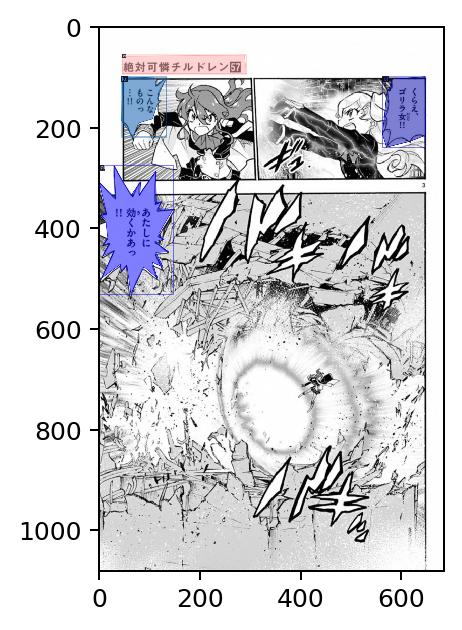

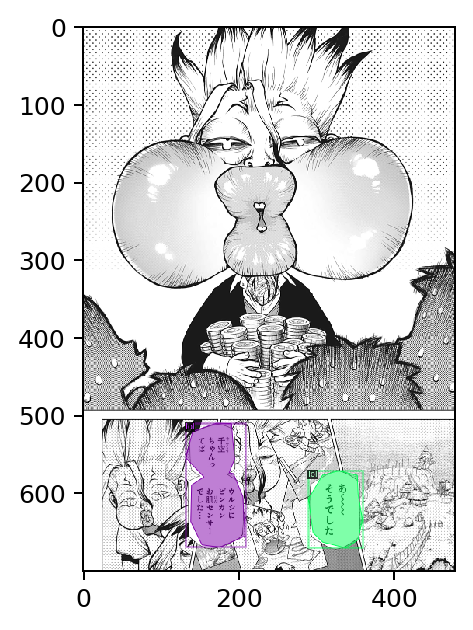

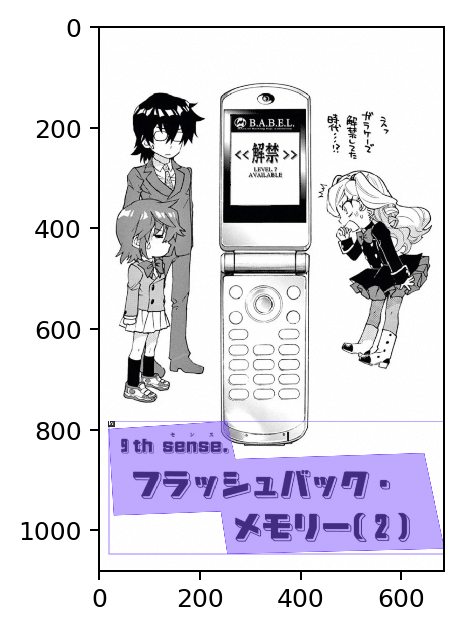

In [13]:
dataset_dicts = get_balloon_dicts("manga/train")
for d in random.sample(dataset_dicts, 3):
    img = cv2.imread(d["file_name"])
    visualizer = Visualizer(img[:, :, ::-1], metadata=balloon_metadata, scale=0.5)
    vis = visualizer.draw_dataset_dict(d)
    plt.figure(dpi=180)
    plt.imshow(vis.get_image()[:, :, ::-1])

## Train!

Now, let's fine-tune a coco-pretrained R50-FPN Mask R-CNN model on the balloon dataset. It takes ~6 minutes to train 300 iterations on Colab's K80 GPU, or ~2 minutes on a P100 GPU.


In [14]:
from detectron2.engine import DefaultTrainer
from detectron2.config import get_cfg

cfg = get_cfg()
cfg.merge_from_file(model_zoo.get_config_file("COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x.yaml"))
cfg.DATASETS.TRAIN = ("lol_train",)
cfg.DATASETS.TEST = ()
cfg.DATALOADER.NUM_WORKERS = 2
cfg.MODEL.WEIGHTS = model_zoo.get_checkpoint_url("COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x.yaml")  # Let training initialize from model zoo
cfg.SOLVER.IMS_PER_BATCH = 2
cfg.SOLVER.BASE_LR = 0.00025  # pick a good LR
cfg.SOLVER.MAX_ITER = 10000    # 300 iterations seems good enough for this toy dataset; you may need to train longer for a practical dataset
cfg.MODEL.ROI_HEADS.BATCH_SIZE_PER_IMAGE = 128   # faster, and good enough for this toy dataset (default: 512)
cfg.MODEL.ROI_HEADS.NUM_CLASSES = 1  # only has one class (ballon)

os.makedirs(cfg.OUTPUT_DIR, exist_ok=True)
trainer = DefaultTrainer(cfg) 
trainer.resume_or_load(resume=False)
trainer.train()

[03/29 23:33:14 d2.engine.defaults]: Model:
GeneralizedRCNN(
  (backbone): FPN(
    (fpn_lateral2): Conv2d(256, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output2): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral3): Conv2d(512, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output3): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral4): Conv2d(1024, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output4): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral5): Conv2d(2048, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output5): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (top_block): LastLevelMaxPool()
    (bottom_up): ResNet(
      (stem): BasicStem(
        (conv1): Conv2d(
          3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False
          (norm): FrozenBatchNorm2d(num_features=64, eps=1e-05)
        )
      )
      (res

[03/29 23:33:22 d2.data.build]: Removed 18 images with no usable annotations. 203 images left.
[03/29 23:33:22 d2.data.build]: Distribution of instances among all 1 categories:
|  category  | #instances   |
|:----------:|:-------------|
|    lol     | 1132         |
|            |              |
[03/29 23:33:22 d2.data.detection_utils]: TransformGens used in training: [ResizeShortestEdge(short_edge_length=(640, 672, 704, 736, 768, 800), max_size=1333, sample_style='choice'), RandomFlip()]
[03/29 23:33:22 d2.data.build]: Using training sampler TrainingSampler


'roi_heads.box_predictor.cls_score.weight' has shape (81, 1024) in the checkpoint but (2, 1024) in the model! Skipped.
'roi_heads.box_predictor.cls_score.bias' has shape (81,) in the checkpoint but (2,) in the model! Skipped.
'roi_heads.box_predictor.bbox_pred.weight' has shape (320, 1024) in the checkpoint but (4, 1024) in the model! Skipped.
'roi_heads.box_predictor.bbox_pred.bias' has shape (320,) in the checkpoint but (4,) in the model! Skipped.
'roi_heads.mask_head.predictor.weight' has shape (80, 256, 1, 1) in the checkpoint but (1, 256, 1, 1) in the model! Skipped.
'roi_heads.mask_head.predictor.bias' has shape (80,) in the checkpoint but (1,) in the model! Skipped.


[03/29 23:33:22 d2.engine.train_loop]: Starting training from iteration 0
[03/29 23:33:49 d2.utils.events]: eta: 3:44:06  iter: 19  total_loss: 1.979  loss_cls: 0.626  loss_box_reg: 0.438  loss_mask: 0.695  loss_rpn_cls: 0.189  loss_rpn_loc: 0.032  time: 1.3328  data_time: 0.0277  lr: 0.000005  max_mem: 2633M
[03/29 23:34:17 d2.utils.events]: eta: 3:48:51  iter: 39  total_loss: 2.026  loss_cls: 0.598  loss_box_reg: 0.504  loss_mask: 0.682  loss_rpn_cls: 0.150  loss_rpn_loc: 0.025  time: 1.3750  data_time: 0.0079  lr: 0.000010  max_mem: 2634M
[03/29 23:34:45 d2.utils.events]: eta: 3:47:59  iter: 59  total_loss: 1.938  loss_cls: 0.561  loss_box_reg: 0.533  loss_mask: 0.659  loss_rpn_cls: 0.155  loss_rpn_loc: 0.033  time: 1.3712  data_time: 0.0068  lr: 0.000015  max_mem: 2635M
[03/29 23:35:13 d2.utils.events]: eta: 3:47:56  iter: 79  total_loss: 1.802  loss_cls: 0.513  loss_box_reg: 0.535  loss_mask: 0.628  loss_rpn_cls: 0.105  loss_rpn_loc: 0.030  time: 1.3799  data_time: 0.0068  lr: 0.0

[03/29 23:49:28 d2.utils.events]: eta: 3:43:07  iter: 679  total_loss: 0.536  loss_cls: 0.112  loss_box_reg: 0.234  loss_mask: 0.157  loss_rpn_cls: 0.003  loss_rpn_loc: 0.013  time: 1.4196  data_time: 0.0070  lr: 0.000170  max_mem: 2635M
[03/29 23:49:58 d2.utils.events]: eta: 3:42:55  iter: 699  total_loss: 0.480  loss_cls: 0.113  loss_box_reg: 0.241  loss_mask: 0.133  loss_rpn_cls: 0.003  loss_rpn_loc: 0.011  time: 1.4214  data_time: 0.0070  lr: 0.000175  max_mem: 2635M
[03/29 23:50:25 d2.utils.events]: eta: 3:42:25  iter: 719  total_loss: 0.457  loss_cls: 0.084  loss_box_reg: 0.228  loss_mask: 0.130  loss_rpn_cls: 0.001  loss_rpn_loc: 0.011  time: 1.4207  data_time: 0.0077  lr: 0.000180  max_mem: 2635M
[03/29 23:50:53 d2.utils.events]: eta: 3:41:53  iter: 739  total_loss: 0.519  loss_cls: 0.109  loss_box_reg: 0.261  loss_mask: 0.148  loss_rpn_cls: 0.002  loss_rpn_loc: 0.009  time: 1.4195  data_time: 0.0073  lr: 0.000185  max_mem: 2635M
[03/29 23:51:21 d2.utils.events]: eta: 3:41:27  

[03/30 00:05:27 d2.utils.events]: eta: 3:25:51  iter: 1359  total_loss: 0.383  loss_cls: 0.073  loss_box_reg: 0.188  loss_mask: 0.122  loss_rpn_cls: 0.000  loss_rpn_loc: 0.011  time: 1.4151  data_time: 0.0070  lr: 0.000250  max_mem: 2635M
[03/30 00:05:57 d2.utils.events]: eta: 3:25:26  iter: 1379  total_loss: 0.402  loss_cls: 0.073  loss_box_reg: 0.177  loss_mask: 0.130  loss_rpn_cls: 0.000  loss_rpn_loc: 0.010  time: 1.4157  data_time: 0.0072  lr: 0.000250  max_mem: 2635M
[03/30 00:06:26 d2.utils.events]: eta: 3:25:20  iter: 1399  total_loss: 0.395  loss_cls: 0.067  loss_box_reg: 0.195  loss_mask: 0.125  loss_rpn_cls: 0.001  loss_rpn_loc: 0.013  time: 1.4168  data_time: 0.0072  lr: 0.000250  max_mem: 2635M
[03/30 00:06:54 d2.utils.events]: eta: 3:24:30  iter: 1419  total_loss: 0.388  loss_cls: 0.074  loss_box_reg: 0.195  loss_mask: 0.114  loss_rpn_cls: 0.002  loss_rpn_loc: 0.012  time: 1.4160  data_time: 0.0073  lr: 0.000250  max_mem: 2635M
[03/30 00:07:21 d2.utils.events]: eta: 3:23:

[03/30 00:21:24 d2.utils.events]: eta: 3:09:16  iter: 2039  total_loss: 0.373  loss_cls: 0.064  loss_box_reg: 0.180  loss_mask: 0.118  loss_rpn_cls: 0.000  loss_rpn_loc: 0.010  time: 1.4120  data_time: 0.0071  lr: 0.000250  max_mem: 2635M
[03/30 00:21:53 d2.utils.events]: eta: 3:08:54  iter: 2059  total_loss: 0.343  loss_cls: 0.055  loss_box_reg: 0.167  loss_mask: 0.110  loss_rpn_cls: 0.000  loss_rpn_loc: 0.010  time: 1.4126  data_time: 0.0073  lr: 0.000250  max_mem: 2635M
[03/30 00:22:21 d2.utils.events]: eta: 3:08:11  iter: 2079  total_loss: 0.345  loss_cls: 0.057  loss_box_reg: 0.172  loss_mask: 0.114  loss_rpn_cls: 0.000  loss_rpn_loc: 0.010  time: 1.4123  data_time: 0.0074  lr: 0.000250  max_mem: 2635M
[03/30 00:22:49 d2.utils.events]: eta: 3:07:52  iter: 2099  total_loss: 0.346  loss_cls: 0.051  loss_box_reg: 0.163  loss_mask: 0.120  loss_rpn_cls: 0.000  loss_rpn_loc: 0.010  time: 1.4123  data_time: 0.0070  lr: 0.000250  max_mem: 2635M
[03/30 00:23:19 d2.utils.events]: eta: 3:07:

[03/30 00:37:22 d2.utils.events]: eta: 2:53:42  iter: 2719  total_loss: 0.390  loss_cls: 0.053  loss_box_reg: 0.177  loss_mask: 0.130  loss_rpn_cls: 0.000  loss_rpn_loc: 0.011  time: 1.4111  data_time: 0.0071  lr: 0.000250  max_mem: 2635M
[03/30 00:37:52 d2.utils.events]: eta: 2:53:14  iter: 2739  total_loss: 0.318  loss_cls: 0.047  loss_box_reg: 0.147  loss_mask: 0.112  loss_rpn_cls: 0.000  loss_rpn_loc: 0.008  time: 1.4116  data_time: 0.0071  lr: 0.000250  max_mem: 2635M
[03/30 00:38:18 d2.utils.events]: eta: 2:52:41  iter: 2759  total_loss: 0.307  loss_cls: 0.039  loss_box_reg: 0.144  loss_mask: 0.109  loss_rpn_cls: 0.000  loss_rpn_loc: 0.010  time: 1.4110  data_time: 0.0069  lr: 0.000250  max_mem: 2635M
[03/30 00:38:47 d2.utils.events]: eta: 2:51:46  iter: 2779  total_loss: 0.344  loss_cls: 0.051  loss_box_reg: 0.156  loss_mask: 0.125  loss_rpn_cls: 0.000  loss_rpn_loc: 0.012  time: 1.4111  data_time: 0.0071  lr: 0.000250  max_mem: 2635M
[03/30 00:39:16 d2.utils.events]: eta: 2:51:

[03/30 00:53:29 d2.utils.events]: eta: 2:38:06  iter: 3399  total_loss: 0.314  loss_cls: 0.043  loss_box_reg: 0.145  loss_mask: 0.107  loss_rpn_cls: 0.000  loss_rpn_loc: 0.007  time: 1.4131  data_time: 0.0076  lr: 0.000250  max_mem: 2635M
[03/30 00:53:57 d2.utils.events]: eta: 2:37:44  iter: 3419  total_loss: 0.322  loss_cls: 0.042  loss_box_reg: 0.148  loss_mask: 0.109  loss_rpn_cls: 0.000  loss_rpn_loc: 0.008  time: 1.4131  data_time: 0.0074  lr: 0.000250  max_mem: 2635M
[03/30 00:54:25 d2.utils.events]: eta: 2:37:18  iter: 3439  total_loss: 0.376  loss_cls: 0.048  loss_box_reg: 0.171  loss_mask: 0.127  loss_rpn_cls: 0.000  loss_rpn_loc: 0.012  time: 1.4131  data_time: 0.0071  lr: 0.000250  max_mem: 2635M
[03/30 00:54:53 d2.utils.events]: eta: 2:36:49  iter: 3459  total_loss: 0.298  loss_cls: 0.047  loss_box_reg: 0.136  loss_mask: 0.106  loss_rpn_cls: 0.000  loss_rpn_loc: 0.008  time: 1.4130  data_time: 0.0070  lr: 0.000250  max_mem: 2635M
[03/30 00:55:21 d2.utils.events]: eta: 2:36:

[03/30 01:09:27 d2.utils.events]: eta: 2:21:38  iter: 4079  total_loss: 0.326  loss_cls: 0.046  loss_box_reg: 0.148  loss_mask: 0.120  loss_rpn_cls: 0.000  loss_rpn_loc: 0.011  time: 1.4124  data_time: 0.0072  lr: 0.000250  max_mem: 2635M
[03/30 01:09:54 d2.utils.events]: eta: 2:21:01  iter: 4099  total_loss: 0.285  loss_cls: 0.049  loss_box_reg: 0.133  loss_mask: 0.107  loss_rpn_cls: 0.000  loss_rpn_loc: 0.011  time: 1.4121  data_time: 0.0070  lr: 0.000250  max_mem: 2635M
[03/30 01:10:23 d2.utils.events]: eta: 2:20:13  iter: 4119  total_loss: 0.293  loss_cls: 0.034  loss_box_reg: 0.138  loss_mask: 0.110  loss_rpn_cls: 0.000  loss_rpn_loc: 0.009  time: 1.4122  data_time: 0.0074  lr: 0.000250  max_mem: 2635M
[03/30 01:10:52 d2.utils.events]: eta: 2:19:43  iter: 4139  total_loss: 0.274  loss_cls: 0.037  loss_box_reg: 0.126  loss_mask: 0.102  loss_rpn_cls: 0.000  loss_rpn_loc: 0.007  time: 1.4124  data_time: 0.0068  lr: 0.000250  max_mem: 2635M
[03/30 01:11:21 d2.utils.events]: eta: 2:19:

[03/30 01:25:37 d2.utils.events]: eta: 2:06:07  iter: 4759  total_loss: 0.270  loss_cls: 0.036  loss_box_reg: 0.120  loss_mask: 0.107  loss_rpn_cls: 0.000  loss_rpn_loc: 0.006  time: 1.4142  data_time: 0.0074  lr: 0.000250  max_mem: 2635M
[03/30 01:26:04 d2.utils.events]: eta: 2:05:28  iter: 4779  total_loss: 0.295  loss_cls: 0.041  loss_box_reg: 0.134  loss_mask: 0.107  loss_rpn_cls: 0.000  loss_rpn_loc: 0.008  time: 1.4140  data_time: 0.0070  lr: 0.000250  max_mem: 2635M
[03/30 01:26:31 d2.utils.events]: eta: 2:04:47  iter: 4799  total_loss: 0.270  loss_cls: 0.033  loss_box_reg: 0.130  loss_mask: 0.113  loss_rpn_cls: 0.000  loss_rpn_loc: 0.009  time: 1.4138  data_time: 0.0070  lr: 0.000250  max_mem: 2635M
[03/30 01:27:00 d2.utils.events]: eta: 2:04:19  iter: 4819  total_loss: 0.273  loss_cls: 0.038  loss_box_reg: 0.130  loss_mask: 0.093  loss_rpn_cls: 0.000  loss_rpn_loc: 0.009  time: 1.4139  data_time: 0.0073  lr: 0.000250  max_mem: 2635M
[03/30 01:27:29 d2.utils.events]: eta: 2:03:

[03/30 01:41:38 d2.utils.events]: eta: 1:49:31  iter: 5439  total_loss: 0.262  loss_cls: 0.036  loss_box_reg: 0.116  loss_mask: 0.097  loss_rpn_cls: 0.000  loss_rpn_loc: 0.007  time: 1.4139  data_time: 0.0078  lr: 0.000250  max_mem: 2635M
[03/30 01:42:04 d2.utils.events]: eta: 1:48:57  iter: 5459  total_loss: 0.299  loss_cls: 0.041  loss_box_reg: 0.135  loss_mask: 0.107  loss_rpn_cls: 0.000  loss_rpn_loc: 0.010  time: 1.4135  data_time: 0.0071  lr: 0.000250  max_mem: 2635M
[03/30 01:42:31 d2.utils.events]: eta: 1:48:21  iter: 5479  total_loss: 0.269  loss_cls: 0.039  loss_box_reg: 0.127  loss_mask: 0.101  loss_rpn_cls: 0.000  loss_rpn_loc: 0.009  time: 1.4134  data_time: 0.0073  lr: 0.000250  max_mem: 2635M
[03/30 01:43:00 d2.utils.events]: eta: 1:47:53  iter: 5499  total_loss: 0.293  loss_cls: 0.043  loss_box_reg: 0.138  loss_mask: 0.102  loss_rpn_cls: 0.000  loss_rpn_loc: 0.010  time: 1.4134  data_time: 0.0078  lr: 0.000250  max_mem: 2635M
[03/30 01:43:28 d2.utils.events]: eta: 1:47:

[03/30 01:57:37 d2.utils.events]: eta: 1:32:39  iter: 6119  total_loss: 0.229  loss_cls: 0.026  loss_box_reg: 0.104  loss_mask: 0.098  loss_rpn_cls: 0.000  loss_rpn_loc: 0.006  time: 1.4134  data_time: 0.0073  lr: 0.000250  max_mem: 2635M
[03/30 01:58:04 d2.utils.events]: eta: 1:32:01  iter: 6139  total_loss: 0.259  loss_cls: 0.034  loss_box_reg: 0.124  loss_mask: 0.106  loss_rpn_cls: 0.000  loss_rpn_loc: 0.008  time: 1.4132  data_time: 0.0069  lr: 0.000250  max_mem: 2635M
[03/30 01:58:32 d2.utils.events]: eta: 1:31:39  iter: 6159  total_loss: 0.276  loss_cls: 0.031  loss_box_reg: 0.122  loss_mask: 0.105  loss_rpn_cls: 0.000  loss_rpn_loc: 0.009  time: 1.4132  data_time: 0.0070  lr: 0.000250  max_mem: 2635M
[03/30 01:59:01 d2.utils.events]: eta: 1:31:09  iter: 6179  total_loss: 0.268  loss_cls: 0.038  loss_box_reg: 0.126  loss_mask: 0.106  loss_rpn_cls: 0.000  loss_rpn_loc: 0.008  time: 1.4133  data_time: 0.0077  lr: 0.000250  max_mem: 2635M
[03/30 01:59:29 d2.utils.events]: eta: 1:30:

[03/30 02:13:36 d2.utils.events]: eta: 1:16:16  iter: 6799  total_loss: 0.257  loss_cls: 0.030  loss_box_reg: 0.114  loss_mask: 0.101  loss_rpn_cls: 0.000  loss_rpn_loc: 0.008  time: 1.4131  data_time: 0.0075  lr: 0.000250  max_mem: 2635M
[03/30 02:14:04 d2.utils.events]: eta: 1:15:43  iter: 6819  total_loss: 0.245  loss_cls: 0.033  loss_box_reg: 0.115  loss_mask: 0.096  loss_rpn_cls: 0.000  loss_rpn_loc: 0.007  time: 1.4130  data_time: 0.0070  lr: 0.000250  max_mem: 2635M
[03/30 02:14:33 d2.utils.events]: eta: 1:15:15  iter: 6839  total_loss: 0.255  loss_cls: 0.032  loss_box_reg: 0.117  loss_mask: 0.103  loss_rpn_cls: 0.000  loss_rpn_loc: 0.007  time: 1.4132  data_time: 0.0074  lr: 0.000250  max_mem: 2635M
[03/30 02:15:01 d2.utils.events]: eta: 1:14:37  iter: 6859  total_loss: 0.250  loss_cls: 0.031  loss_box_reg: 0.115  loss_mask: 0.099  loss_rpn_cls: 0.000  loss_rpn_loc: 0.009  time: 1.4130  data_time: 0.0075  lr: 0.000250  max_mem: 2635M
[03/30 02:15:30 d2.utils.events]: eta: 1:14:

[03/30 02:29:36 d2.utils.events]: eta: 0:59:51  iter: 7479  total_loss: 0.248  loss_cls: 0.036  loss_box_reg: 0.116  loss_mask: 0.106  loss_rpn_cls: 0.000  loss_rpn_loc: 0.007  time: 1.4129  data_time: 0.0069  lr: 0.000250  max_mem: 2635M
[03/30 02:30:05 d2.utils.events]: eta: 0:59:24  iter: 7499  total_loss: 0.248  loss_cls: 0.030  loss_box_reg: 0.106  loss_mask: 0.100  loss_rpn_cls: 0.000  loss_rpn_loc: 0.008  time: 1.4130  data_time: 0.0078  lr: 0.000250  max_mem: 2635M
[03/30 02:30:32 d2.utils.events]: eta: 0:58:52  iter: 7519  total_loss: 0.235  loss_cls: 0.034  loss_box_reg: 0.105  loss_mask: 0.099  loss_rpn_cls: 0.000  loss_rpn_loc: 0.008  time: 1.4129  data_time: 0.0073  lr: 0.000250  max_mem: 2635M
[03/30 02:31:01 d2.utils.events]: eta: 0:58:24  iter: 7539  total_loss: 0.281  loss_cls: 0.031  loss_box_reg: 0.125  loss_mask: 0.097  loss_rpn_cls: 0.000  loss_rpn_loc: 0.008  time: 1.4129  data_time: 0.0073  lr: 0.000250  max_mem: 2635M
[03/30 02:31:30 d2.utils.events]: eta: 0:57:

[03/30 02:45:37 d2.utils.events]: eta: 0:43:45  iter: 8159  total_loss: 0.254  loss_cls: 0.030  loss_box_reg: 0.107  loss_mask: 0.099  loss_rpn_cls: 0.000  loss_rpn_loc: 0.007  time: 1.4129  data_time: 0.0072  lr: 0.000250  max_mem: 2635M
[03/30 02:46:06 d2.utils.events]: eta: 0:43:18  iter: 8179  total_loss: 0.245  loss_cls: 0.035  loss_box_reg: 0.108  loss_mask: 0.100  loss_rpn_cls: 0.000  loss_rpn_loc: 0.007  time: 1.4129  data_time: 0.0069  lr: 0.000250  max_mem: 2635M
[03/30 02:46:35 d2.utils.events]: eta: 0:42:58  iter: 8199  total_loss: 0.255  loss_cls: 0.029  loss_box_reg: 0.113  loss_mask: 0.100  loss_rpn_cls: 0.000  loss_rpn_loc: 0.008  time: 1.4130  data_time: 0.0075  lr: 0.000250  max_mem: 2635M
[03/30 02:47:03 d2.utils.events]: eta: 0:42:31  iter: 8219  total_loss: 0.256  loss_cls: 0.041  loss_box_reg: 0.101  loss_mask: 0.092  loss_rpn_cls: 0.000  loss_rpn_loc: 0.008  time: 1.4130  data_time: 0.0072  lr: 0.000250  max_mem: 2635M
[03/30 02:47:31 d2.utils.events]: eta: 0:42:

[03/30 03:01:32 d2.utils.events]: eta: 0:27:38  iter: 8839  total_loss: 0.255  loss_cls: 0.031  loss_box_reg: 0.113  loss_mask: 0.107  loss_rpn_cls: 0.000  loss_rpn_loc: 0.009  time: 1.4121  data_time: 0.0072  lr: 0.000250  max_mem: 2635M
[03/30 03:01:59 d2.utils.events]: eta: 0:27:09  iter: 8859  total_loss: 0.235  loss_cls: 0.031  loss_box_reg: 0.107  loss_mask: 0.094  loss_rpn_cls: 0.000  loss_rpn_loc: 0.007  time: 1.4121  data_time: 0.0073  lr: 0.000250  max_mem: 2635M
[03/30 03:02:29 d2.utils.events]: eta: 0:26:42  iter: 8879  total_loss: 0.232  loss_cls: 0.031  loss_box_reg: 0.088  loss_mask: 0.096  loss_rpn_cls: 0.000  loss_rpn_loc: 0.006  time: 1.4123  data_time: 0.0076  lr: 0.000250  max_mem: 2635M
[03/30 03:02:57 d2.utils.events]: eta: 0:26:12  iter: 8899  total_loss: 0.251  loss_cls: 0.032  loss_box_reg: 0.102  loss_mask: 0.102  loss_rpn_cls: 0.000  loss_rpn_loc: 0.007  time: 1.4122  data_time: 0.0072  lr: 0.000250  max_mem: 2635M
[03/30 03:03:26 d2.utils.events]: eta: 0:25:

[03/30 03:17:29 d2.utils.events]: eta: 0:11:27  iter: 9519  total_loss: 0.258  loss_cls: 0.031  loss_box_reg: 0.111  loss_mask: 0.095  loss_rpn_cls: 0.000  loss_rpn_loc: 0.008  time: 1.4118  data_time: 0.0072  lr: 0.000250  max_mem: 2635M
[03/30 03:17:57 d2.utils.events]: eta: 0:10:59  iter: 9539  total_loss: 0.235  loss_cls: 0.033  loss_box_reg: 0.092  loss_mask: 0.103  loss_rpn_cls: 0.000  loss_rpn_loc: 0.006  time: 1.4118  data_time: 0.0072  lr: 0.000250  max_mem: 2635M
[03/30 03:18:26 d2.utils.events]: eta: 0:10:32  iter: 9559  total_loss: 0.233  loss_cls: 0.028  loss_box_reg: 0.097  loss_mask: 0.103  loss_rpn_cls: 0.000  loss_rpn_loc: 0.006  time: 1.4118  data_time: 0.0074  lr: 0.000250  max_mem: 2635M
[03/30 03:18:54 d2.utils.events]: eta: 0:10:03  iter: 9579  total_loss: 0.223  loss_cls: 0.028  loss_box_reg: 0.107  loss_mask: 0.084  loss_rpn_cls: 0.000  loss_rpn_loc: 0.007  time: 1.4118  data_time: 0.0074  lr: 0.000250  max_mem: 2635M
[03/30 03:19:21 d2.utils.events]: eta: 0:09:

In [16]:
# Look at training curves in tensorboard:
%load_ext tensorboard
%tensorboard --logdir output

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard


Reusing TensorBoard on port 6006 (pid 10902), started 3:58:15 ago. (Use '!kill 10902' to kill it.)

## Inference & evaluation using the trained model
Now, let's run inference with the trained model on the balloon validation dataset. First, let's create a predictor using the model we just trained:



In [17]:
cfg.MODEL.WEIGHTS = os.path.join(cfg.OUTPUT_DIR, "model_final.pth")
cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.7   # set the testing threshold for this model
cfg.DATASETS.TEST = ("lol_valid", )
predictor = DefaultPredictor(cfg)

In [21]:
files = os.listdir('./manga/vaild/')

In [23]:
d

'332.jpg'

Then, we randomly select several samples to visualize the prediction results.

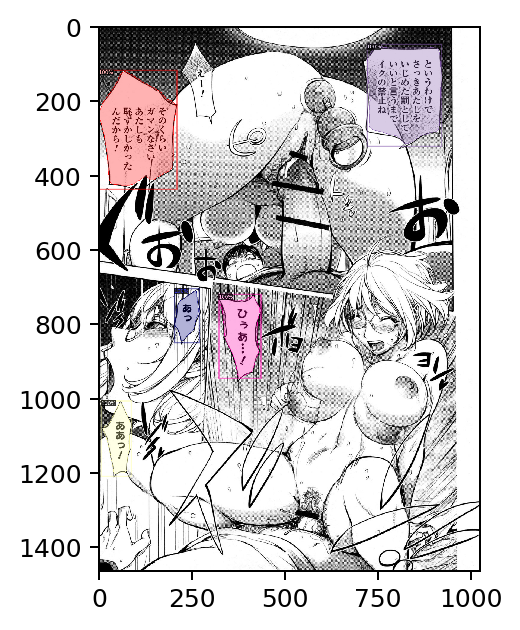

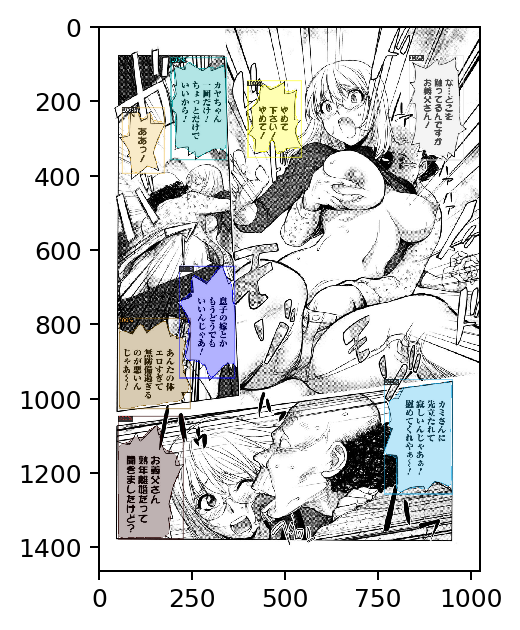

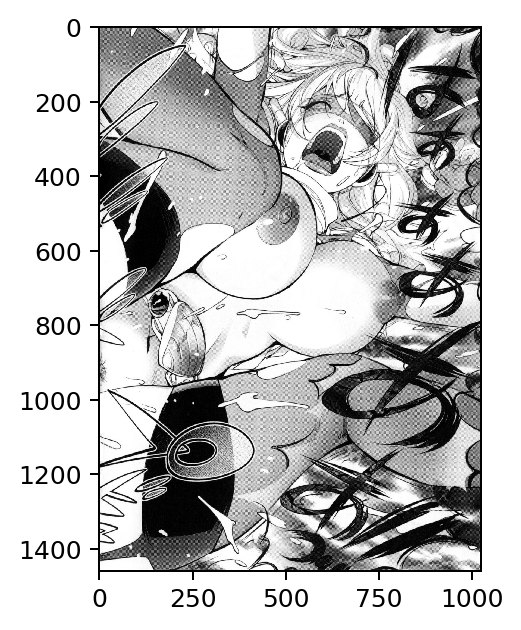

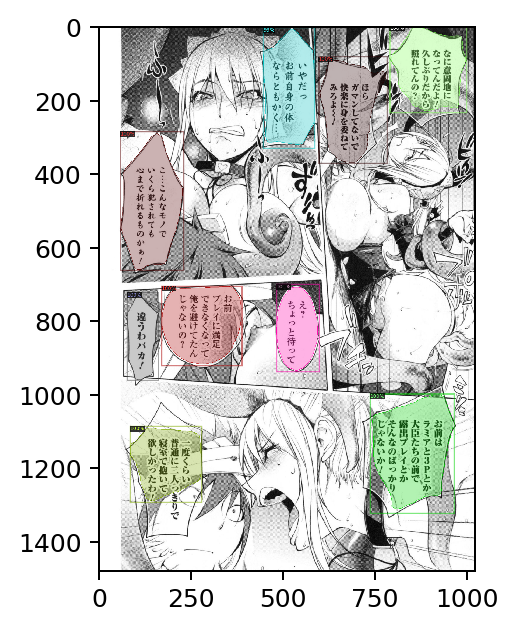

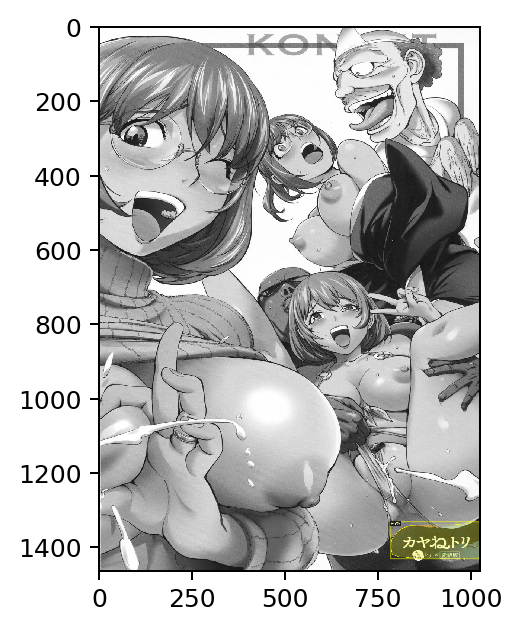

...

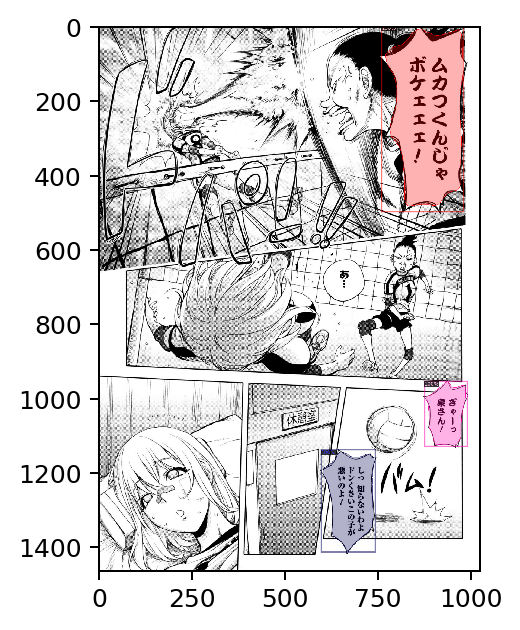

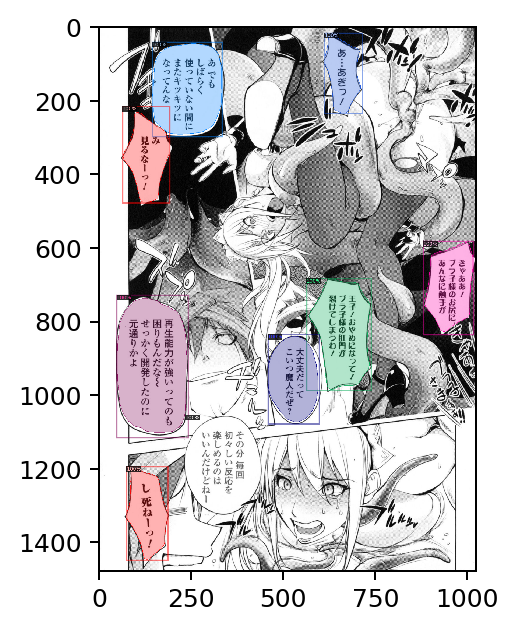

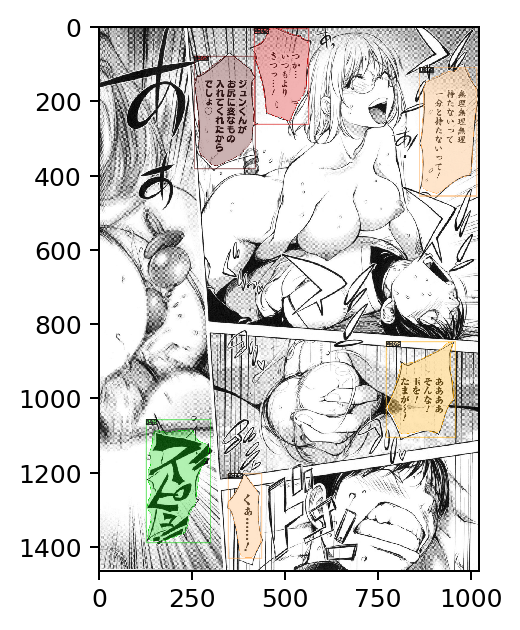

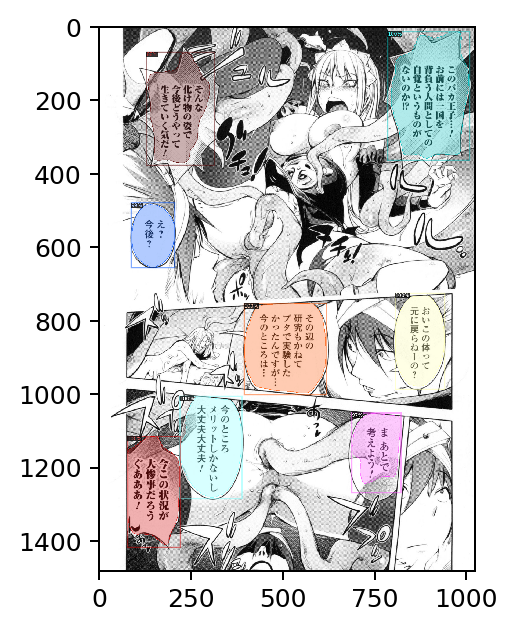

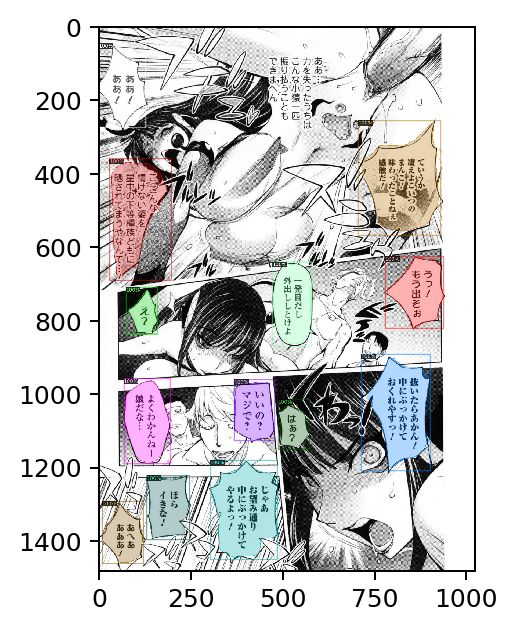

In [27]:
from detectron2.utils.visualizer import ColorMode
dataset_dicts = get_balloon_dicts("share_Data/valid")
for d in random.sample(files, 20):    
    im = cv2.imread('./manga/vaild/{}'.format(d))
    outputs = predictor(im)
    v = Visualizer(im[:, :, ::-1],
                   metadata=balloon_metadata, 
                   scale=0.8, 
                   instance_mode=ColorMode.IMAGE_BW   # remove the colors of unsegmented pixels
    )
    v = v.draw_instance_predictions(outputs["instances"].to("cpu"))
    plt.figure(dpi=180)
    plt.imshow(v.get_image()[:, :, ::-1])

We can also evaluate its performance using AP metric implemented in COCO API.
This gives an AP of ~70%. Not bad!

In [0]:
from detectron2.evaluation import COCOEvaluator, inference_on_dataset
from detectron2.data import build_detection_test_loader
evaluator = COCOEvaluator("balloon_val", cfg, False, output_dir="./output/")
val_loader = build_detection_test_loader(cfg, "balloon_val")
inference_on_dataset(trainer.model, val_loader, evaluator)
# another equivalent way is to use trainer.test

[11/15 04:10:32 d2.evaluation.evaluator]: Start inference on 13 images
[11/15 04:10:46 d2.evaluation.evaluator]: Total inference time: 0:00:05 (0.625000 s / img per device, on 1 devices)
[11/15 04:10:46 d2.evaluation.evaluator]: Total inference pure compute time: 0:00:03 (0.437190 s / img per device, on 1 devices)
[11/15 04:10:46 d2.evaluation.coco_evaluation]: Preparing results for COCO format ...
[11/15 04:10:46 d2.evaluation.coco_evaluation]: Saving results to ./output/coco_instances_results.json
[11/15 04:10:46 d2.evaluation.coco_evaluation]: Evaluating predictions ...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
DONE (t=0.13s).
Accumulating evaluation results...
DONE (t=0.02s).
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.681
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.849
 Average Precision  (AP) @[ IoU=0.75      | area

OrderedDict([('bbox',
              {'AP': 68.13251528146942,
               'AP50': 84.9277873853965,
               'AP75': 82.8068039080166,
               'APl': 81.58885128967246,
               'APm': 57.23126698500541,
               'APs': 1.1056105610561056}),
             ('segm',
              {'AP': 76.97562111397131,
               'AP50': 84.64734364022362,
               'AP75': 84.01711775272273,
               'APl': 93.63197968598362,
               'APm': 58.887208805837645,
               'APs': 0.763201320132013})])

# Other types of builtin models

WARNING [10/15 06:33:32 d2.config.compat]: Config './detectron2_repo/configs/COCO-Keypoints/keypoint_rcnn_R_50_FPN_3x.yaml' has no VERSION. Assuming it to be compatible with latest v2.


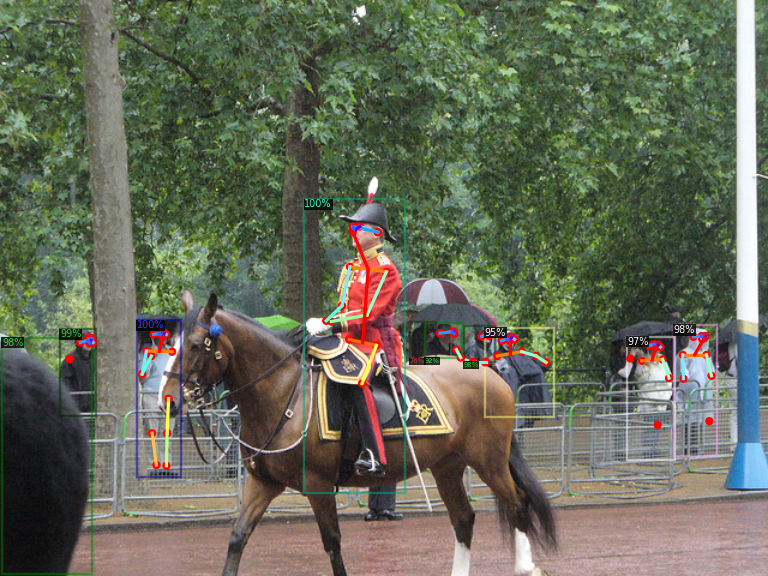

In [0]:
# Inference with a keypoint detection model
cfg = get_cfg()
cfg.merge_from_file(model_zoo.get_config_file("COCO-Keypoints/keypoint_rcnn_R_50_FPN_3x.yaml"))
cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.7  # set threshold for this model
cfg.MODEL.WEIGHTS = model_zoo.get_checkpoint_url("COCO-Keypoints/keypoint_rcnn_R_50_FPN_3x.yaml")
predictor = DefaultPredictor(cfg)
outputs = predictor(im)
v = Visualizer(im[:,:,::-1], MetadataCatalog.get(cfg.DATASETS.TRAIN[0]), scale=1.2)
v = v.draw_instance_predictions(outputs["instances"].to("cpu"))
cv2_imshow(v.get_image()[:, :, ::-1])

WARNING [10/15 06:33:37 d2.config.compat]: Config './detectron2_repo/configs/COCO-PanopticSegmentation/panoptic_fpn_R_101_3x.yaml' has no VERSION. Assuming it to be compatible with latest v2.


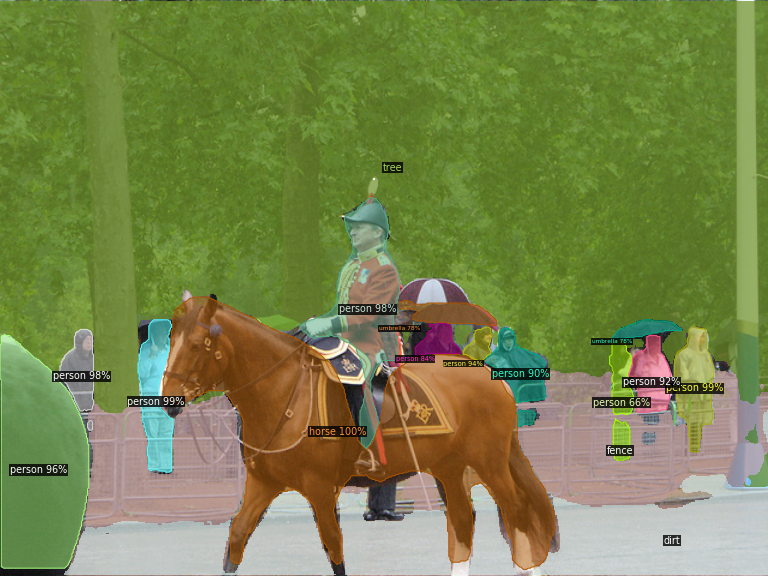

In [0]:
# Inference with a panoptic segmentation model
cfg = get_cfg()
cfg.merge_from_file(model_zoo.get_config_file("COCO-PanopticSegmentation/panoptic_fpn_R_101_3x.yaml"))
cfg.MODEL.WEIGHTS = model_zoo.get_checkpoint_url("COCO-PanopticSegmentation/panoptic_fpn_R_101_3x.yaml")
predictor = DefaultPredictor(cfg)
panoptic_seg, segments_info = predictor(im)["panoptic_seg"]
v = Visualizer(im[:, :, ::-1], MetadataCatalog.get(cfg.DATASETS.TRAIN[0]), scale=1.2)
v = v.draw_panoptic_seg_predictions(panoptic_seg.to("cpu"), segments_info)
cv2_imshow(v.get_image()[:, :, ::-1])

# Run panoptic segmentation on a video

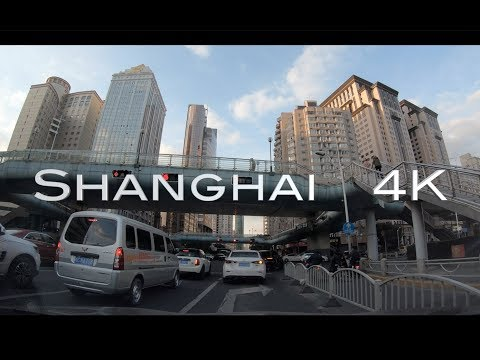

In [0]:
# This is the video we're going to process
from IPython.display import YouTubeVideo, display
video = YouTubeVideo("ll8TgCZ0plk", width=500)
display(video)

In [0]:
# Install dependencies, download the video, and crop 5 seconds for processing
!pip install youtube-dl
!pip uninstall -y opencv-python opencv-contrib-python
!apt install python3-opencv  # the one pre-installed have some issues
!youtube-dl https://www.youtube.com/watch?v=ll8TgCZ0plk -f 22 -o video.mp4
!ffmpeg -i video.mp4 -t 00:00:06 -c:v copy video-clip.mp4

In [0]:
# Run frame-by-frame inference demo on this video (takes 3-4 minutes)
# Using a model trained on COCO dataset
!git clone https://github.com/facebookresearch/detectron2
!python detectron2/demo/demo.py --config-file detectron2/configs/COCO-PanopticSegmentation/panoptic_fpn_R_101_3x.yaml --video-input video-clip.mp4 --confidence-threshold 0.6 --output video-output.mkv \
  --opts MODEL.WEIGHTS detectron2://COCO-PanopticSegmentation/panoptic_fpn_R_101_3x/139514519/model_final_cafdb1.pkl

In [0]:
# Download the results
from google.colab import files
files.download('video-output.mkv')